# Evaluation & Analysis

In [1]:
import os
os.chdir('../')

%load_ext autoreload
%autoreload 2

In [2]:
import fnmatch
import os
import sys
import time
import traceback
from pydoc import locate

import numpy as np

# TensorFlow 2.x compatibility
try:
    import tensorboard  # pylint: disable=import-error
    import tensorflow  # pylint: disable=import-error
    tensorflow.io.gfile = tensorboard.compat.tensorflow_stub.io.gfile
except (ModuleNotFoundError, AttributeError):
    pass

import torch
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch.utils.data

import distiller.apputils as apputils

# pylint: enable=no-name-in-module
import ai8x
import datasets
import parse_qat_yaml
import parsecmd

In [3]:
from train_test import create_model, update_old_model_params

## MAIN

In [4]:
"""main"""
#script_dir = os.path.dirname(__file__)
#script_dir = os. getcwd()

supported_models = []
supported_sources = []
model_names = []
dataset_names = []

In [5]:
# Dynamically load models
for _, _, files in sorted(os.walk('models')):
    for name in sorted(files):
        if fnmatch.fnmatch(name, '*.py'):
            fn = 'models.' + name[:-3]
            m = locate(fn)
            try:
                for i in m.models:
                    i['module'] = fn
                supported_models += m.models
                model_names += [item['name'] for item in m.models]
            except AttributeError:
                # Skip files that don't have 'models' or 'models.name'
                pass
# Dynamically load datasets
for _, _, files in sorted(os.walk('datasets')):
    for name in sorted(files):
        if fnmatch.fnmatch(name, '*.py'):
            ds = locate('datasets.' + name[:-3])
            try:
                supported_sources += ds.datasets
                dataset_names += [item['name'] for item in ds.datasets]
            except AttributeError:
                # Skip files that don't have 'datasets' or 'datasets.name'
                pass

In [6]:
# Parse arguments
cmd_line_args = """
    --epochs 1 --lr 3e-3 --optimizer Adam
    --deterministic --qat-policy qat_policy_wavenet.yaml --compress schedule_tcn.yaml 
    --model ai85reswavenet --dataset PEDALNET 
    --device MAX78000
    --regression
    --use-bias
    --custom-loss
"""
args = parsecmd.get_parser(model_names, dataset_names).parse_args(cmd_line_args.split())

In [7]:
args.ai8x_device = args.device

In [8]:
#def set_device():
#    # Set hardware device
#    ai8x.set_device(args.device, args.act_mode_8bit, args.avg_pool_rounding)
#set_device()


def init_stuff(args):
    ai8x.set_device(args.ai8x_device, args.act_mode_8bit, args.avg_pool_rounding)


    if args.cpu or not torch.cuda.is_available():
        if not args.cpu:
            print("WARNING: CUDA hardware acceleration is not available, training will be slow") # Print warning if no hardware acceleration
        # Set GPU index to -1 if using CPU
        args.device = 'cpu'
        args.gpus = -1
    else:
        args.device = 'cuda'
        if args.gpus is not None:
            try:
                args.gpus = [int(s) for s in args.gpus.split(',')]
            except ValueError as exc:
                raise ValueError('ERROR: Argument --gpus must be a comma-separated '
                                 'list of integers only') from exc
            available_gpus = torch.cuda.device_count()
            for dev_id in args.gpus:
                if dev_id >= available_gpus:
                    raise ValueError('ERROR: GPU device ID {0} requested, but only {1} '
                                     'devices available'
                                     .format(dev_id, available_gpus))
            # Set default device in case the first one on the list != 0
            torch.cuda.set_device(args.gpus[0])

    # DCOM dataset selection (regression vs classification)
    selected_source = next((item for item in supported_sources if item['name'] == args.dataset))
    args.labels = selected_source['output']
    args.num_classes = len(args.labels)
    if args.num_classes == 1 \
       or ('regression' in selected_source and selected_source['regression']):
        args.regression = True
    dimensions = selected_source['input']
    if len(dimensions) == 2:
        dimensions += (1, )
    args.dimensions = dimensions

    args.datasets_fn = selected_source['loader']


    # Get policy for quantization aware training
    qat_policy = parse_qat_yaml.parse(args.qat_policy) \
        if args.qat_policy.lower() != "none" else None

    # Get policy for once for all training policy
    nas_policy = parse_nas_yaml.parse(args.nas_policy) \
        if args.nas and args.nas_policy.lower() != '' else None

    #if not args.load_serialized and args.gpus != -1 and torch.cuda.device_count() > 1:
    #    model = torch.nn.DataParallel(model, device_ids=args.gpus).to(args.device)
    
    return qat_policy
qat_policy = init_stuff(args)

Configuring device: MAX78000, simulate=False.
{'start_epoch': 100000000, 'weight_bits': 8}


### Load dataset

In [9]:
# Load the datasets
train_loader, val_loader, test_loader, _ = apputils.get_data_loaders(
    args.datasets_fn, (os.path.expanduser(args.data), args), args.batch_size,
    args.workers, args.validation_split, args.deterministic,
    args.effective_train_size, args.effective_valid_size, args.effective_test_size)

## ARGS

# RESULSTS

In [70]:
import IPython.display as ipd
import pickle
from matplotlib import pyplot as plt
import json
import argparse
%matplotlib inline    

#logs/remote/2021.12.07-021439__resimple_ch12_d8p2_lr1e-3_dith0hi0_qearly_test working simplenet test
#2021.12.08-152558__resimple_ch12_d8p2_lr1e-3_dith0hi0_qearly_test
model_path = "./logs/remote/2021.12.08-221248__resimple_CH12_ch12_d8p2_lr1e-3_dith2.0hi17000_qearly_multich/" #"2021.11.11-123430_res+skip+yes_res_convs"
#model_path = "./logs/remote/2021.12.03-190134__res_ch12_d10p2_lr1e-3__qearly__qsearch/" #"2021.11.11-123430_res+skip+yes_res_convs"

#model_path = "./logs/remote/2021.11.08-105618/"
#model_path = "./logs/remote/2021.11.03-144708/"
#model_path = "./logs/remote/2021.11.02-175213/"


#args.load_model_path = model_path+"checkpoint.pth.tar"
#args.load_model_path = model_path+"best.pth.tar"

args.load_model_path = model_path+"r"+model_path.split("__r")[-1].split("/")[-2]+"_best.pth.tar"
args.load_model_path_qat = model_path+"r"+model_path.split("__r")[-1].split("/")[-2]+"_qat_best.pth.tar"
#args.load_model_path = model_path+model_path.split("__")[-1].split("/")[-2]+"_qat_checkpoint.pth.tar"
act_mode_8bit=False
print(args.load_model_path)

./logs/remote/2021.12.08-221248__resimple_CH12_ch12_d8p2_lr1e-3_dith2.0hi17000_qearly_multich/resimple_CH12_ch12_d8p2_lr1e-3_dith2.0hi17000_qearly_multich_best.pth.tar


In [71]:
#parser = argparse.ArgumentParser()
#args1 = parser.parse_args()
with open(model_path+'configs/commandline_args.txt', 'r') as f:
    loaded_args = json.load(f)
args.num_hidden_channels = loaded_args["num_hidden_channels"]
print("num hidden channels",args.num_hidden_channels)


args.dilation_depth = loaded_args["dilation_depth"]
args.dilation_power = loaded_args["dilation_power"]
args.num_repeat = loaded_args["num_repeat"]
args.kernel_size = loaded_args["kernel_size"]

args.output_bitdepth = loaded_args["output_bitdepth"]
args.pre_filter_coeff = loaded_args["pre_filter_coeff"]
args.dataset = loaded_args["dataset"]

args.cnn = loaded_args["cnn"]
print("model",args.cnn)
print("dl",args.dilation_depth,"  p",args.dilation_power,"  r",args.num_repeat,"  k",args.kernel_size)

#dithering
if "dither_std" not in loaded_args.keys():
    args.dither_std = 0
else:
    args.dither_std = loaded_args["dither_std"]
    args.dither_hicutoff = loaded_args["dither_hicutoff"]
print("Dither std:",args.dither_std,"hicutoff:",args.dither_hicutoff)
    

num hidden channels 12
model ai85simplewavenet
dl 8   p 2   r 1   k 3
Dither std: 2.0 hicutoff: 17000


In [36]:
for key in loaded_args.keys():
    if key == "load_model_path":
        continue
    args.__dict__[key] = loaded_args[key]
args.ai8x_device = args.device
#args.__dict__["output_bitdepth"] = 8

In [37]:
#args.dataset = "PEDALNET"
#args.dither_std = 0.5
#args.dither_hicutoff = 10000
#args.cnn = "ai85semireswavenet_noskip_test"
#args.num_hidden_channels = 12
#args.dilation_depth = 2
#args.dilation_power = 2
#args.kernel_size = 3
args.act_mode_8bit = act_mode_8bit

In [38]:
qat_policy = init_stuff(args)
#ai8x.set_device(args.ai8x_device, args.act_mode_8bit, args.avg_pool_rounding)

Configuring device: MAX78000, simulate=False.
{'start_epoch': 100, 'weight_bits': 8}


In [39]:
def load_model(load_model_path,supported_models,args):
    model = create_model(supported_models, args.dimensions, args)
    
    update_old_model_params(load_model_path, model)
    if qat_policy is not None:
        checkpoint = torch.load(args.load_model_path,
                                map_location=lambda storage, loc: storage)
        if checkpoint.get('epoch', None) >= qat_policy['start_epoch']:
            ai8x.fuse_bn_layers(model)
    model = apputils.load_lean_checkpoint(model, load_model_path,
                                          model_device=args.device)
    ai8x.update_model(model)

    model.eval()
    print("Model loaded correctly")
    return model
    
model = load_model(args.load_model_path,supported_models,args)
model_qat = load_model(args.load_model_path_qat,supported_models,args)

Model loaded correctly
Model loaded correctly


In [16]:
checkpoint = torch.load(args.load_model_path,map_location=torch.device('cpu'))

In [146]:
# Load the datasets
train_loader, val_loader, test_loader, _ = apputils.get_data_loaders(
    args.datasets_fn, (os.path.expanduser(args.data), args), args.batch_size,
    args.workers, args.validation_split, args.deterministic,
    args.effective_train_size, args.effective_valid_size, args.effective_test_size)

In [147]:
#load dataset if not already loaded

#try: inputs
#except:
(inputs, target) = next(iter(train_loader))
    
sr = 44100
sample_size = 4410 #HAS to be the same as x_train.size(2)
#out_sample_size = 2362

### 8 Bit inference test

In [543]:
inputs.min()

tensor(-0.6875)

In [17]:
samples = np.load("../ai8x-synthesis/tests/sample_pedalnet.npy")
samples = samples.reshape(1,1,1024)

if not args.act_mode_8bit:
    samples = samples/128.
samples[:,:,:10]

array([[[-0.046875 , -0.0390625, -0.0390625, -0.03125  , -0.0234375,
         -0.015625 , -0.0078125,  0.       ,  0.015625 ,  0.0234375]]])

In [19]:
quantizer = model_qat.linear_mix.quantize

In [57]:
#remove last layer activation quantization (wide = true!)
model_qat.linear_mix.quantize = ai8x.Empty()

In [21]:
output = model(torch.tensor(samples).type(torch.float))
output_qat = model_qat(torch.tensor(samples).type(torch.float))

In [22]:
#model.hidden[0].op.weight

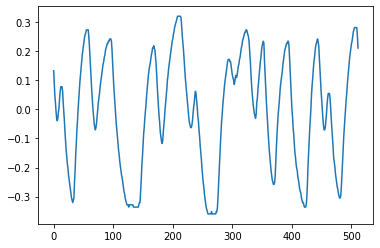

In [23]:
plt.plot(output_qat.detach().flatten())

In [24]:
out = """ 9798   6949   3302   1956   -146   -770  -2454  -1582    -21    388   2411   3721   4658   4493   4934   4044   1615   -982  -3184  -6123  -7663 -10492 -12382 -13088 -14463 -15850  -17320 -18303 -19475 -20644 -21060 -21482 -22452 -21737 -20662 -17211 -14710 -11114  -8016  -4968  -2690   -408   2451   4235   6525   8189   9796  11405  12617  13773  14867  16070   16911  17510  18263  18361  18915  18378  17809  17347  15438  12344  10154   7129   3912   1786    201  -1771  -3017  -4114  -3761  -3210  -3372  -1551   -152   1124   2154   2672    4760   4984   6546   7667   8600   9736  10661  11018  11599  12451  13754  13886  14278  14559  15173  14829  15192  15315  15835  15217  13023  10152   7565   4844   2749    307   -2027  -3638  -5021  -6351  -8356  -9686 -10851 -12563 -13466 -14646 -15447 -16882 -17907 -18578 -19090 -20187 -21272 -21678 -21847 -22689 -22980 -22773 -23245 -22593 -22647 -22914  -22359 -22605 -22883 -23264 -23109 -22742 -22925 -22968 -22880 -22820 -22932 -22907 -22326 -22067 -21362 -20550 -17356 -15936 -12652 -11071  -8166  -6157  -3644  -2069   -452   1968    3217   4973   7005   7869   9301  10542  11524  11963  12397  13562  14425  14714  14553  14816  14112  12971  11044   8897   5727   4134   1552   -917  -2171  -3852  -5997  -6742   -6545  -6113  -5206  -3175  -2248   -511   1911   3193   4246   6753   7865   9285  10224  11937  12682  13496  14559  15075  15918  16469  17903  18224  18945  19917  20115  20821   21276  21820  21408  21426  21150  20463  20524  18499  16739  14849  13748  11237   9188   6504   5509   3661   1911    699  -1203  -2690  -3759  -5016  -5086  -4678  -4323  -2915   -1423     56   1262   2585   4263   3564   1700   -365  -1734  -3703  -5216  -7102  -9253 -10477 -11387 -13235 -15268 -16966 -17820 -19566 -20723 -21590 -22419 -23187 -23761 -24661  -24790 -24363 -24404 -24609 -24426 -24329 -24723 -24436 -25059 -24794 -24546 -24546 -23969 -23321 -23008 -21363 -18872 -15387 -11132  -8962  -6980  -4094  -1455    554   1898   3656    5000   6216   7340   8722   9644  10538  11789  11721  12421  12131  11649  11825  10850  10454   8915   8456   7799   7559   7270   8040   7792   8154   8715   9913  10167  11079   11436  12127  12863  13628  14103  14862  16377  16804  16877  17467  17570  17531  17912  17333  16969  16041  15765  13787  12551   9079   7194   4725   3289   1008    353  -1338   -1108  -1707   -886   1413   2945   5028   6940   8085   9906  11083  12250  13220  14318  14876  15365  14582  10727   7839   4984   1642   -921  -3784  -5492  -7720  -9424 -11122  -12944 -14492 -15072 -15857 -17038 -17609 -18362 -17553 -15300 -11803  -9021  -5407  -3924  -1954    422   2251   3683   5294   7354   8045   9077  10088  11560  11792  13331  13983   14939  15070  14672  15494  15282  14475  12534   9991   6497   2530   -146  -1796  -4563  -6238  -8081  -9571 -11375 -13189 -13600 -14817 -16173 -17063 -18267 -18773 -20190 -20908  -21799 -21502 -22429 -22465 -23501 -23785 -24021 -24000 -23504 -21500 -17970 -13396 -10125  -7194  -5135  -1489   1566   3860   6099   8128   9603  11129  12448  13350  14716  15709   16112  16346  16198  14869  13019   9708   7956   5057   2435   -255  -1822  -3237  -4147  -4162  -3295  -1512   -441   1175   2616   2945   3819   3740   2003    192  -2637  -4501   -6451  -9207 -11567 -13390 -14244 -15383 -16074 -17648 -18573 -19381 -19980 -20559 -20984 -21202 -20576 -17847 -16166 -12678  -9847  -6977  -4281  -2340   -173   2089   4357   5658    7211   8993  10559  12617  13007  14097  15143  16047  16571  18167  18343  19107  19339  19546  19083  18340  16580  14288"""

In [25]:
#out = """9215   7453   5418   3761   2668   1348    611    378    285    444    746   1695   2472   3420   4451   5348   3730    969  -1856  -4292  -6012  -7966  -9057  -9831 -10903 -11626 -12071 -12167 -12499 -12723 -12829 -12996 -12977 -12832 -12803 -12322 -11549  -9116  -7247  -4282  -1683    768   2923   5401   7230   8717   9601  10755  11534  12338  12620  13029  13400  13680  13808  13843  13849  13724  13472  13076  12380  11530   9529   7411   5851   4433   2580   1063   -308   -985   -993   -888   -520    119    500   1289   1717   2291 3527   4797   6450   8475   9773  10587  10918  11142  11393  11620  11806  11780  11931  11913  11748  11490  11261  11115  10859  10521  10149   8893   6848   5145   3421   1641    -264  -1815  -3589  -5098  -6658  -7596  -8870  -9828 -10980 -11652 -12568 -13165 -13472 -13519 -13653 -13669 -13637 -13644 -13890 -13829 -13823 -13798 -13707 -13779 -13655 -13345  -13092 -12968 -12565 -11987 -11536 -11323 -11084 -10900 -10934 -11066 -11110 -10838 -10408 -10206  -9014  -7559  -6400  -5315  -3867  -2241   -851    628   2052   3506   5041   6283    7263   8527   9139  10170  10564  10922  11242  11553  11921  11890  11902  11833  11623  11251  10825  10122   9242   8242   6641   4763   3194   1724    197  -1481  -2983  -3847   -4271  -4289  -4392  -3305  -1876    122   1458   3223   4097   5215   6298   7433   8454   9551  10030  10632  10983  11537  11942  12127  12436  12555  12574  12654  12781  12612   12564  12250  12177  12139  12242  12134  11937  11774  11183  10512   9805   9153   8170   7161   6473   5306   4031   3385   2408   1765   1490   1453   1333   1483   1618   1483    2081   2614   3579   3989   4725   4852   4531   3823   2253   -274  -3020  -5204  -6281  -7617  -8691  -9624 -10714 -11562 -12218 -12381 -12664 -12875 -13140 -13365 -13292 -13382  -13379 -13448 -13318 -13280 -13335 -13208 -13170 -12999 -12805 -12905 -12346 -11415 -10688 -10391 -10345  -9754  -9354  -8405  -6711  -5252  -3309  -1584    131   2774   4987   6484    7577   8439   9355   9608   9802   9888  10063   9888   9761   9488   9182   8771   8138   7318   6526   5516   4498   3858   2564   2758   3456   4584   5674   7211   7619   8062    8848   9139   9480   9502   9630   9566   9566   9794  10203  10551  10623  10811  10600  10391  10134   9770   9485   8874   8622   7699   6804   5441   4170   3186   2702   1899    1875   1929   2381   3205   4918   6192   7240   8033   8962   9788  10422  11056  11306  11482  11529  11203  10526   8979   5728   1677   -626  -2237  -4209  -5980  -8204  -9947  -10988 -11759 -12276 -12322 -12184 -12162 -12283 -12102 -11358 -11055 -10093  -8638  -6652  -4178  -1854    139   2217   3803   4838   5390   6351   7612   9066  10334  11598  12193   11990  11733  11459  11126  11004  11074  11035   9572   6930   4018   1785    100  -1902  -4156  -6419  -8874 -10616 -11739 -12353 -12700 -12985 -12909 -12839 -12988 -13167 -13347  -13286 -13485 -13488 -13332 -13332 -13243 -13173 -12976 -12688 -12255 -10817  -9354  -7622  -5153  -2728   -382   1972   3844   6141   7893   8675   9299  10082  10551  10848  11088   11088  11290  11070  10996  10717   9400   8017   5551   3431   1238   -321   -951  -2018  -2388  -2473  -1672  -1007     18    893   1962   2989   3986   4404   3373    933  -1700    -4213  -6285  -7636  -8673  -9605 -10641 -11529 -11882 -12398 -12843 -12867 -12820 -12599 -12688 -12587 -12484 -11881 -10395  -7957  -6083  -3783  -1588   1244   3313   5330   6606     8177   9565  10845  11516  12006  12598  13107  13303  13674  13814  13971  14085  14040  13970  13894  13498  13054  11916"""
out = out.split()
outs = []
for i in out:
    outs.append(int(i))
outs = np.array(outs)

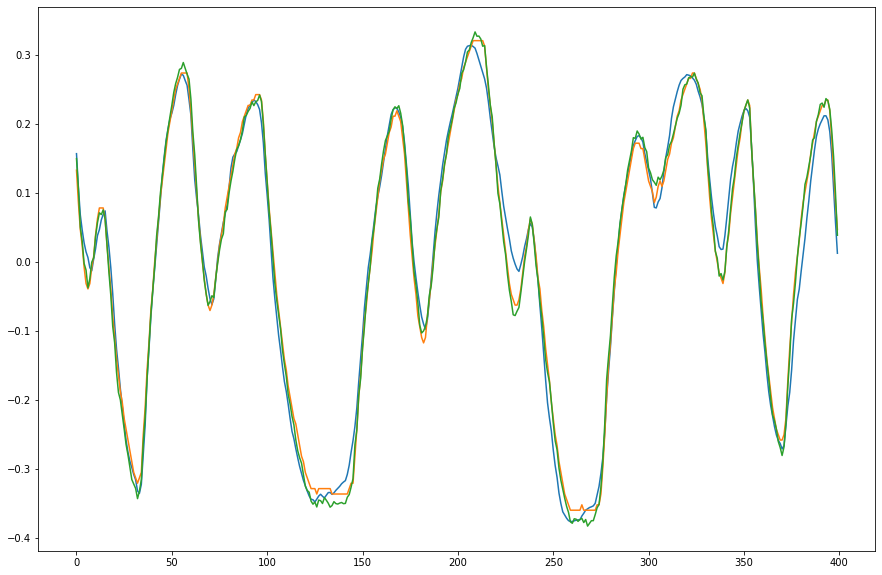

In [33]:
n = 400
wide_scaling = 2**16
scaling = 1/2**16
plt.figure(figsize=(15,10))
plt.plot(output.detach().flatten()[:n]*wide_scaling*scaling)
plt.plot(output_qat.detach().flatten()[:n]*wide_scaling*scaling)
plt.plot(outs[:n]*scaling)

In [149]:
output = model(inputs[:10,:,:])

In [981]:
plt.plot(output[:10,0,:].flatten().detach())
plt.plot(target[:10,0,:].flatten().detach())

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x000001FF999C8670> (for post_execute):


RuntimeError: xelatex not found.  Install it or change rcParams['pgf.texsystem'] to an available TeX implementation.

RuntimeError: No suitable pdf to png renderer found.

<Figure size 432x288 with 1 Axes>

In [55]:
args.cnn = "ai85semireswavenet_noskip_test"
args.num_hidden_channels = 12
args.dilation_depth = 2
args.dilation_power = 2
args.kernel_size = 3

In [56]:
model = create_model(supported_models, dimensions, args)

In [50]:
#model

In [52]:
model(inputs).shape

torch.Size([256, 1, 1022])

In [44]:
#model.residual_0.op.weight.data

In [45]:
t = torch.rand((1,12,10))

In [46]:
#model.residual_0.op(t)

In [31]:
inputs = inputs[:,:,:1024]

In [32]:
outputs = model(inputs)

In [309]:
outputs.shape

torch.Size([256, 1, 1016])

In [92]:
for inputs, target in test_loader:
    print(inputs.shape)

torch.Size([256, 1, 4410])
torch.Size([118, 1, 4410])


In [93]:
#plt.plot(inputs.flatten())
ipd.Audio(inputs.flatten(),rate=sr)

In [196]:
#plt.plot(inputs[0,0,:100])

In [70]:
l = 4410
t = torch.linspace(0,l/sr,l)
#inputs = torch.sin(t*8000).reshape(1,1,l)
#inputs[0,0,:3000]=0
#target = inputs.clone()[:,:,-out_sample_size:]

#DELTA
l = 4410
#inputs = torch.zeros(1,1,l)
#inputs[0,0,l//2+100] = 1

In [75]:
outputs = model(inputs)
out_sample_size = outputs.size(2)
print(out_sample_size)

2222


In [199]:
sample = 230 #106#20 #170 #84      #
n_samples = 1000
fig = plt.figure(figsize=(10,6))
#plt.plot(inputs.detach()[sample,0,-out_sample_size:-out_sample_size+n_samples])#-out_sample_size:-out_sample_size+n_samples])
#plt.plot(target.detach()[sample,0,-out_sample_size:-out_sample_size+n_samples])#
#plt.plot(outputs.detach()[sample,0,:n_samples])

<Figure size 720x432 with 0 Axes>

In [74]:
ipd.Audio(np.concatenate((outputs).squeeze().detach().numpy()),rate=sr)

In [29]:
ipd.Audio(np.concatenate((target).squeeze().detach().numpy()),rate=sr)

In [62]:
ipd.Audio(np.concatenate((inputs).squeeze().detach().numpy()),rate=sr)

In [60]:
#LOAD original PEDALNET MODEL
from model_relu import WaveNet
model_pedalnet = WaveNet(num_channels=8,dilation_depth=10,num_repeat=1)
model = create_model(supported_models, dimensions, args)

# Evaluate

In [41]:
def error_to_signal(y, y_pred,pre_filter_coeff):
    """
    Error to signal ratio with pre-emphasis filter:
    https://www.mdpi.com/2076-3417/10/3/766/htm
    """
    y, y_pred = pre_emphasis_filter(y,pre_filter_coeff), pre_emphasis_filter(y_pred,pre_filter_coeff)
    return (y - y_pred).pow(2).sum(dim=2) / (y.pow(2).sum(dim=2) + 1e-10)

def pre_emphasis_filter(x, coeff=0.95):
    return torch.cat((x[:, :, 0:1], x[:, :, 1:] - coeff * x[:, :, :-1]), dim=2)

In [42]:
from scipy.signal import butter, lfilter
def butter_highpass(lowcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    b, a = butter(order, [low], btype='highpass')
    return b, a
def butter_highpass_filter(data, lowcut, fs, order=5):
    b, a = butter_highpass(lowcut, fs, order=order)
    y = lfilter(b, a, data)
    return y
def butter_lowpass(highcut, fs, order=5):
    nyq = 0.5 * fs
    high = highcut / nyq
    b, a = butter(order, [high], btype='lowpass')
    return b, a
def butter_lowpass_filter(data, highcut, fs, order=5):
    b, a = butter_lowpass(highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y
def create_dithering_noise(shape,sr,std,lowcut,order=1,pdf="normal"):
    """Creates dithering noises of the given shape, to be added to  signal
    Args:
        shape: shape of the array
        sr: sampling rate
        std: in normal case, std deviation with respect to quant level, in triangualr case is max noise value
        lowcut: cutoff freq of low pass filter on dithering noise
        pdf: "triangular" or "normal"
    """
    # dithering noise (gaussian psd)
    #N = x_test_f.size #input (x lenght)
    q_step = (1./128)
    dither_std = std*q_step #lowest with still good results
    if pdf=="normal":
        dither_noise = np.random.randn(*shape)*dither_std
    elif pdf=="triangular":
        dither_noise = np.random.triangular(-dither_std,0,dither_std,shape)
    else:
        raise Exception("Invalid noise pdf",pdf) 
    #noise shaping / dither filtering
    #dither_noise_2 = butter_highpass_filter(dither_noise_2, lowcut, sr, order=order)
    dither_noise = butter_highpass_filter(dither_noise, lowcut, sr, order=order)
    return dither_noise.astype(np.float32)

In [43]:
#args.dither_pdf = "triangular"
#args.dither_std = 1.0
#args.dither_hicutoff = 10000

In [89]:
args.dither_std = 3.0

dither pdf: triangular dither std: 3.0 dither order: 1 dither hicutoff: 17000
x_test shape  (70, 12, 4410)
pad_x_test shape (70, 12, 8820)


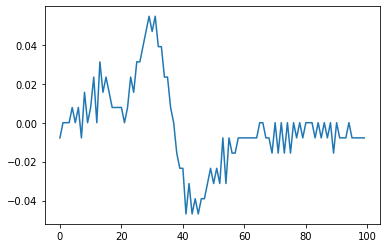

In [90]:
# prepare and load test data
sr = 44100
n_samples = 70 #*sr

if args.dataset in ["PEDALNET","PEDALNET_FLOAT","PEDALNET_CH12"]:
    data = pickle.load(open("data/AUDIO/data.pickle", "rb"))
elif args.dataset in ["PEDALNET_15XOS","PEDALNET_15XOS_FLOAT"]:
    data = pickle.load(open("data/AUDIO/data_1.5xos.pickle", "rb"))
elif args.dataset in ["PEDALNET_2XOS","PEDALNET_2XOS_FLOAT"]:
    data = pickle.load(open("data/AUDIO/data_2xos.pickle", "rb"))
else:
    raise Exception("Unknown dataset",args.dataset)


x_test = data["x_test"] #/data["x_test"].max()
y_test = data["y_test"] #/data["y_test"].max()

#normalization
x_complete = np.concatenate([data["x_train"],data["x_valid"],data["x_test"]])
y_complete = np.concatenate([data["y_train"],data["y_valid"],data["y_test"]])

x_test = x_test[:n_samples]
y_test = y_test[:n_samples]

x_test = x_test/x_complete.max()
y_test = y_test/y_complete.max()


#MULTICHANNEL
if args.dataset == "PEDALNET_CH12":
    n_input_channels = 12
    x_test = np.repeat(x_test,n_input_channels,axis=1)

#quantization
quantize = True
if not args.dataset=="PEDALNET_FLOAT" and quantize:
    # DITHERING
    print("dither pdf:",args.dither_pdf,"dither std:",args.dither_std,"dither order:",args.dither_order,"dither hicutoff:",args.dither_hicutoff)
    if args.dither_std > 0:
        x_test = x_test + create_dithering_noise(x_test.shape,sr,args.dither_std,args.dither_hicutoff,args.dither_order,args.dither_pdf)
    
    x_test = (x_test*0.5*256.).round().clip(min=-128, max=127)/(128.)
    #y_test = (y_test*0.5*256.).round().clip(min=-128, max=127)/(128.)

#integer rescaling
if  args.act_mode_8bit:
    x_test = x_test*256
    y_test = y_test*256
    

prev_sample = np.concatenate((np.zeros_like(x_test[0:1]), x_test[:-1]), axis=0)
pad_x_test = np.concatenate((prev_sample, x_test), axis=2)

pad_x_test = pad_x_test[:n_samples,:,:]

print("x_test shape ",x_test.shape)
print("pad_x_test shape",pad_x_test.shape)
plt.plot(x_test.flatten()[100:200])

In [91]:
y_pred = []
for x in np.array_split(pad_x_test, 10):
    y_pred.append(model(torch.from_numpy(x)).detach().numpy())
y_pred = np.concatenate(y_pred)
y_pred = y_pred[:, :, -x_test.shape[2] :]
y_pred_f = np.concatenate(y_pred.squeeze())
y_test_f = y_test.flatten()

In [92]:
#remove last layer quantization
model_qat.linear_mix.quantize = ai8x.Empty()

In [93]:
#QAT
y_pred_qat = []
for x in np.array_split(pad_x_test, 10):
    #y_pred_qat.append(model_qat(torch.from_numpy(x)).detach().numpy()*0.5)
    y_pred_qat.append(model_qat(torch.from_numpy(x)).detach().numpy()*0.5)
y_pred_qat = np.concatenate(y_pred_qat)
y_pred_qat = y_pred_qat[:, :, -x_test.shape[2] :]
y_pred_qat_f = np.concatenate(y_pred.squeeze())
y_test_f = y_test.flatten()

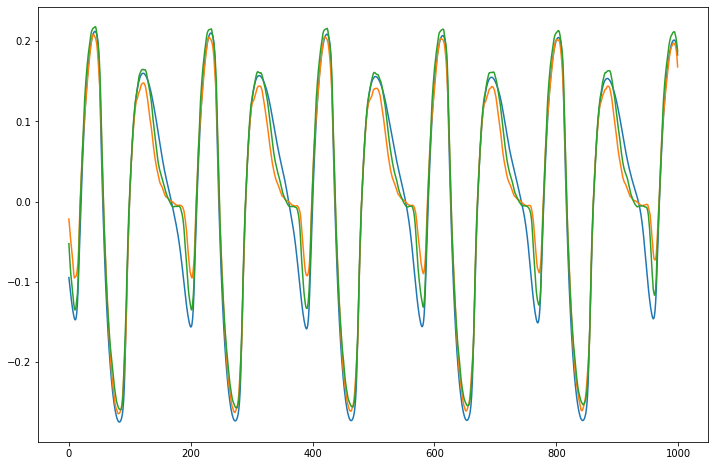

In [86]:
#detail
lenght = 1000
sample=40
plt.figure(figsize=(12,8))
plt.plot(y_test[sample,0,:lenght])
#plt.plot(y_pred_filt[sample,0,:lenght])
plt.plot(y_pred[sample,0,:lenght])
plt.plot(y_pred_qat[sample,0,:lenght])

In [64]:
# compute loss
args.pre_filter_coeff=0.95
criterion = model.get_loss_criterion(args)
criterion(torch.tensor(y_pred),torch.tensor(y_test))

Using custom loss


tensor(0.1143)

In [65]:
error_to_signal(torch.tensor(y_test),torch.tensor(y_pred),0.95).mean()

tensor(0.1143)

In [328]:
y_pred_filt = butter_lowpass_filter(y_pred,1000,sr,1)

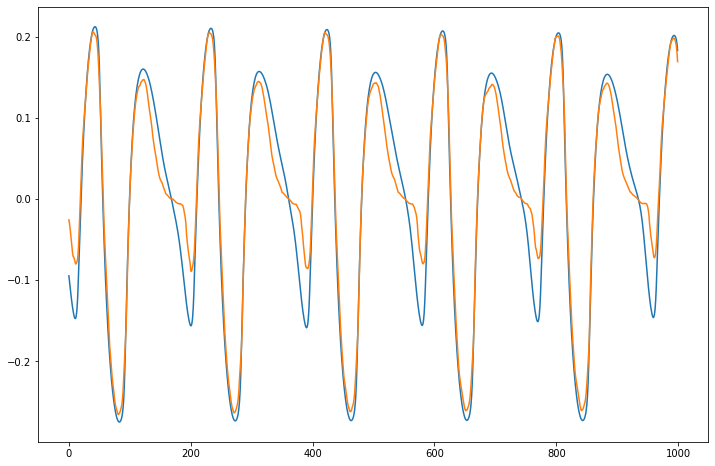

In [66]:
#detail
lenght = 1000
sample=40
plt.figure(figsize=(12,8))
plt.plot(y_test[sample,0,:lenght])
#plt.plot(y_pred_filt[sample,0,:lenght])
plt.plot(y_pred[sample,0,:lenght])

In [94]:
ipd.Audio(np.concatenate(y_pred.squeeze()),rate=sr)

In [95]:
ipd.Audio(np.concatenate(y_pred_qat.squeeze()),rate=sr)

In [69]:
ipd.Audio(np.concatenate(y_test.squeeze()),rate=sr)

In [65]:
y_filt =  butter_lowpass_filter(y_pred.flatten(),14000,sr,order=4).reshape(y_pred.shape)
ipd.Audio(np.concatenate(y_filt.squeeze()),rate=sr)

NameError: name 'butter_lowpass_filter' is not defined

In [273]:
ipd.Audio(np.concatenate(y_test.squeeze()),rate=sr)

In [67]:
ipd.Audio(np.concatenate(x_test.squeeze()),rate=sr)

## PSD analysis

In [706]:
y_pred = []
for x in np.array_split(pad_x_test, 10):
    y_pred.append(model(torch.from_numpy(x)).detach().numpy())
y_pred = np.concatenate(y_pred)
y_pred = y_pred[:, :, -x_test.shape[2] :]
y_pred_f = np.concatenate(y_pred.squeeze())
y_test_f = y_test.flatten()

In [707]:
sr = 44100
l = sr*10
f = 440
t = np.linspace(0,l/sr,l)
t = t[:y_test_f.size]
sin = np.sin(2*np.pi*f*t)

In [708]:
#FFT

def compute_psd(y,sr,smooth=1):
    
    kernel = np.ones(smooth) / smooth

    n_freqs = len(y)//2

    psd  = np.abs(np.fft.fft(y))

    r = 44100
    n = psd.size
    timestep = 1/sr
    freq = np.fft.fftfreq(n, d=timestep)
    
    psd = np.convolve(psd,kernel,mode="same")
    
    return psd[:n_freqs],freq[:n_freqs]
    
#y_pred_psd,freq = compute_psd(y_pred_f,sr,1)
#n_freqs = 10000000
#kernel = np.ones(100) / 100
#plt.plot(freq,y_pred_psd)
#plt.plot(freq[:n_freqs],np.convolve(y_pred_psd,kernel,mode='same')[:n_freqs])
#plt.ylim(0,10)

In [709]:
def plt_psd(y,sr,smooth=1,scaling='log'):

    y_psd,freq = compute_psd(y,sr,smooth)

    plt.figure(figsize=(10,4))
    plt.yscale(scaling)
    plt.xscale(scaling)
    plt.plot(freq,y_psd)
#plt_psd(y_pred_f,sr)

(-3.0, 1.5)

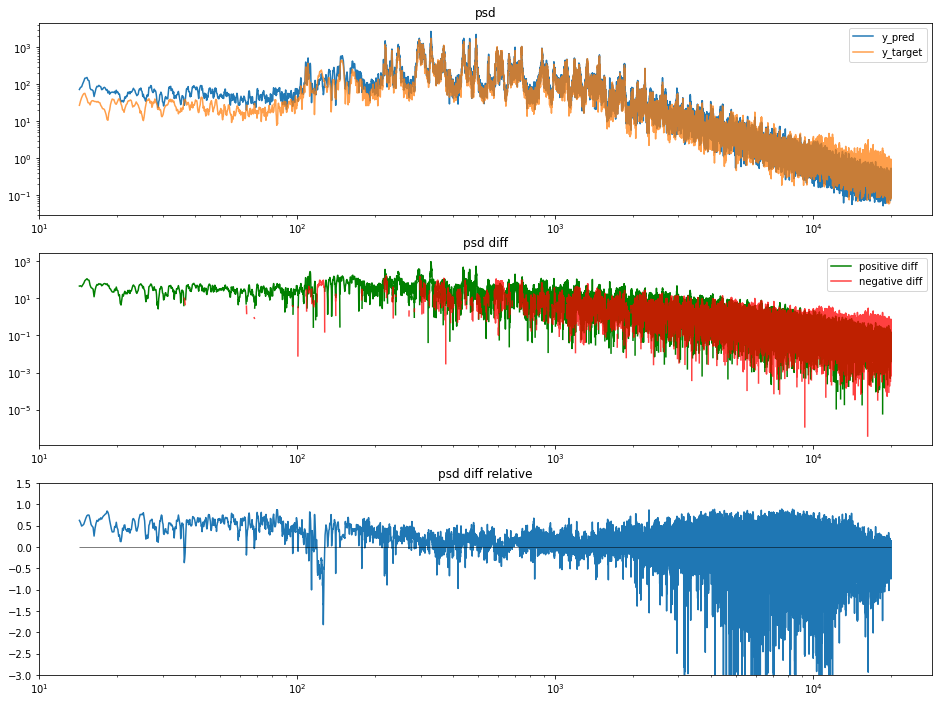

In [710]:
#plot psd differences
freq_a = 100#800*10
freq_b = 200000*n_samples//100 #830*10

x_scale = 'log' #log or linear
y_scale = 'log'

smooth_psd = 5
smooth_diffs = 1

y_pred_psd,freq = compute_psd(y_pred_f,sr,smooth_psd)
y_test_psd,freq = compute_psd(y_test_f,sr,smooth_psd)

y_diff_abs = y_test_psd-y_pred_psd
y_diff_rel = (y_test_psd-y_pred_psd)/np.maximum(np.abs(y_test_psd),1)

#smood diffs
kernel = np.ones(smooth_diffs) / smooth_diffs
y_diff_abs = np.convolve(y_diff_abs,kernel,mode="same")
y_diff_rel = np.convolve(y_diff_rel,kernel,mode="same")

plt.figure(figsize=(16,12))
plt.subplot(3,1,1)
plt.title("psd")
plt.yscale(y_scale)
plt.xscale(x_scale)
plt.hlines(0,freq[freq_a],freq[freq_b],color="grey",linestyles='solid',linewidth=2)
plt.plot(freq[freq_a:freq_b],y_test_psd[freq_a:freq_b],alpha=0.99,label='y_pred')
plt.plot(freq[freq_a:freq_b],y_pred_psd[freq_a:freq_b],alpha=0.75,label='y_target')
plt.legend()
#plt.plot(freq[freq_a:freq_b],y_diff_abs[freq_a:freq_b]-600)
#plt.plot(freq[freq_a:freq_b],y_diff_rel[freq_a:freq_b]*100-1000)
#plt.ylim(-0,1500)

plt.subplot(3,1,2)
plt.title("psd diff")
plt.yscale(y_scale)
plt.xscale(x_scale)
plt.hlines(0,freq[freq_a],freq[freq_b],color="k",linestyles='solid',linewidth=0.5,zorder=1)
#plt.plot(freq[freq_a:freq_b],np.abs(y_diff_abs[freq_a:freq_b]),zorder=1)
y_diff_pos = np.maximum(y_diff_abs[freq_a:freq_b],0)
y_diff_pos[y_diff_pos==0] = np.nan
y_diff_neg = np.minimum(y_diff_abs[freq_a:freq_b],0)
y_diff_neg[y_diff_neg==0] = np.nan
plt.plot(freq[freq_a:freq_b],y_diff_pos,color="g",zorder=1,label='positive diff')
plt.plot(freq[freq_a:freq_b],np.abs(y_diff_neg),color="r",alpha=0.75,zorder=1,label='negative diff')
plt.legend()
#plt.ylim(-200,240)

# interesting plot: error for each freq in PERCENTAGE of the amount of that freq in y target!
plt.subplot(3,1,3)
plt.title("psd diff relative")
plt.yscale("linear")
plt.xscale(x_scale)
plt.hlines(0,freq[freq_a],freq[freq_b],color="k",linestyles='solid',linewidth=0.5,zorder=2)
plt.plot(freq[freq_a:freq_b],y_diff_rel[freq_a:freq_b],zorder=1)
plt.ylim(-3,1.5)

(-1000.0, 2000.0)

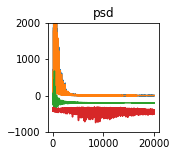

In [37]:
plt.figure(figsize=(2,2))
plt.title("psd")
plt.plot(freq[freq_a:freq_b],y_test_psd[freq_a:freq_b])
plt.plot(freq[freq_a:freq_b],y_pred_psd[freq_a:freq_b])
plt.plot(freq[freq_a:freq_b],y_diff_abs[freq_a:freq_b]-200)
plt.plot(freq[freq_a:freq_b],y_diff_rel[freq_a:freq_b]*100-400)
plt.ylim(-1000,2000)

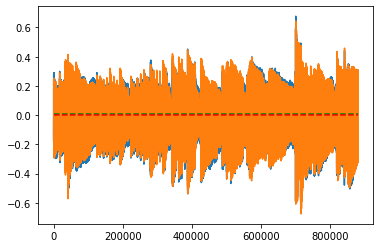

In [38]:
plt.plot(y_test_f,zorder=1)
plt.plot(y_pred_f,zorder=2)
plt.hlines(y_pred_f.mean(),0,y_test_f.size,color="green",linestyles='dashed',zorder=3)
plt.hlines(y_test_f.mean(),0,y_pred_f.size,color="red",linestyles='dashed',zorder=4)

### Conclusions
1. mean of prediction NOT zero (bias I am looking at you) -> big err at 0 freq
2. the ABS err is mostly at LOW-MID frequencies -> try to REMOVE pre filter, or increase those freq in the error
    1. possible reason is because of RELU use -> automatically we get more higher order harmonics thus need to boos mid freqs
3. relative error (in %) is high between 12/15 Khz
4. relative error: low freq NEED to be bosted, high freq need to be made small

### Filtering test

In [96]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

In [97]:
def butter_lowpass(highcut, fs, order=5):
    nyq = 0.5 * fs
    #low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [high], btype='lowpass')
    return b, a

def butter_lowpass_filter(data, highcut, fs, order=5):
    b, a = butter_lowpass(highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def butter_highpass(lowcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    #high = highcut / nyq
    b, a = butter(order, [low], btype='highpass')
    return b, a

def butter_highpass_filter(data, lowcut, fs, order=5):
    b, a = butter_highpass(lowcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

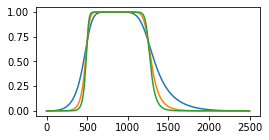

In [98]:
# Sample rate and desired cutoff frequencies (in Hz).
fs = 5000.0
lowcut = 500.0
highcut = 1250.0

# Plot the frequency response for a few different orders.
plt.figure(figsize=(4,2,))
plt.clf()
for order in [3, 6, 9]:
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    w, h = freqz(b, a, worN=2000)
    plt.plot((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

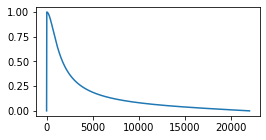

In [58]:
#bandpass filter
lowcut = 1
highcut = 1000
order = 1

b, a = butter_bandpass(lowcut, highcut, sr, order=order)
w, h = freqz(b, a, worN=2000)
plt.figure(figsize=(4,2,))
plt.plot((sr * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

In [44]:
lowcut = 100
highcut = 9000
order = 4
y_pred_filt = butter_bandpass_filter(y_pred_f,lowcut, highcut, sr, order=order)
y_test_filt = butter_bandpass_filter(y_test_f,lowcut, highcut, sr, order=order)

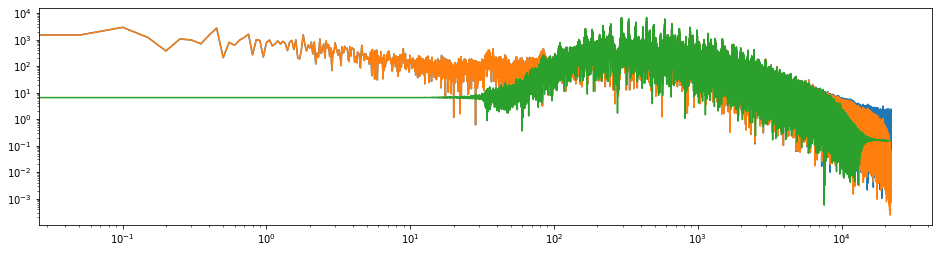

In [57]:
#plt_psd(y_pred_f,sr)
smooth=1
y_psd,freq = compute_psd(y_pred_f,sr,smooth)
y_pred_filt_psd,freq = compute_psd(y_pred_filt,sr,smooth)
y_test_filt_psd,freq = compute_psd(y_test_filt,sr,smooth)

scaling='log'
plt.figure(figsize=(16,4))
plt.yscale(scaling)
plt.xscale(scaling)
plt.plot(freq,y_psd)
plt.plot(freq,y_pred_filt_psd)
plt.plot(freq,y_test_filt_psd)

In [95]:
#lowpass filter
highcut = 17000
order = 1
b, a = butter_lowpass(highcut, sr, order=order)
w, h = freqz(b, a, worN=2000)
plt.figure(figsize=(4,2,))
plt.plot((sr * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

NameError: name 'butter_lowpass' is not defined

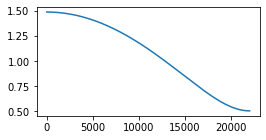

In [99]:
#lowpass filter
highcut = 17000
order = 1
#b, a = butter_lowpass(highcut, sr, order=order)
wz = 1000
w1 = 10000
#b = [wz, 1.]
#a = [w1, 1.]

b = [1., 0.5]
a = [1., 0.01]

w, h = freqz(b, a, worN=2000)
plt.figure(figsize=(4,2,))
plt.plot((sr * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

In [356]:
def pre_emphasis_filter(x, coeff=0.95):
    return torch.cat((x[:, :, 0:1], x[:, :, 1:] - coeff * x[:, :, :-1]), dim=2)

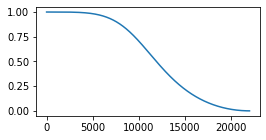

In [106]:
#lowpass filter
highcut = 10000
order = 2
b, a = butter_lowpass(highcut, sr, order=order)
w, h = freqz(b, a, worN=2000)
plt.figure(figsize=(4,2,))
plt.plot((sr * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

In [191]:
#TRY TO FILTER y PRED to make it similar to 
#slight low pass (1 order)
highcut = 5000
order = 5
y_pred_filt = butter_lowpass_filter(y_pred_f, highcut, sr, order=order)
y_test_filt = butter_lowpass_filter(y_test_f, highcut, sr, order=order)

In [192]:
#y_pred_filt = pre_emphasis_filter(torch.Tensor(y_pred),coeff=.95).flatten()

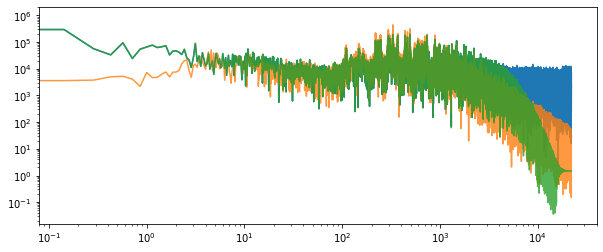

In [193]:
#plt_psd(y_pred_f,sr)
smooth=1
y_psd,freq = compute_psd(y_pred_f,sr,smooth)
y_pred_filt_psd,freq = compute_psd(y_pred_filt,sr,smooth)
y_test_f_psd,freq = compute_psd(y_test_f,sr,smooth)

scaling='log'
plt.figure(figsize=(10,4))
plt.yscale(scaling)
plt.xscale(scaling)

plt.plot(freq,y_psd)
plt.plot(freq,y_test_f_psd,alpha=0.8)
plt.plot(freq,y_pred_filt_psd,alpha=0.8)


In [194]:
start_f = 0 #60000
ipd.Audio(y_pred_filt[start_f:],rate=sr)

In [195]:
ipd.Audio(y_test_filt[start_f:],rate=sr)

In [105]:
ipd.Audio(y_pred_f[start_f:],rate=sr)

In [104]:
ipd.Audio(y_test_f[start_f:],rate=sr)

## DITHERING

Starting test with dithering

Roadmap
1. uniform dithering
2. highpassed dithering (noise shaping)
3. dithering in oversampled region

In [749]:
# prepare and load test data
sr = 44100
n_samples = 100 #*sr

data = pickle.load(open("data/AUDIO/data.pickle", "rb"))
x_test = data["x_test"] #/data["x_test"].max()
y_test = data["y_test"] #/data["y_test"].max()

#normalization
x_complete = np.concatenate([data["x_train"],data["x_valid"],data["x_test"]])
y_complete = np.concatenate([data["y_train"],data["y_valid"],data["y_test"]])

x_test = x_test[:n_samples]
y_test = y_test[:n_samples]

x_test = x_test/x_complete.max()
y_test = y_test/y_complete.max()

x_test_f = x_test.flatten()

#quantization
#if not args.dataset=="PEDALNET_FLOAT":
#    x_test = (x_test*0.5*256.).round().clip(min=-128, max=127)/(128.)
#    y_test = (y_test*0.5*256.).round().clip(min=-128, max=127)/(128.)

def prepare_x(x_test):
    prev_sample = np.concatenate((np.zeros_like(x_test[0:1]), x_test[:-1]), axis=0)
    pad_x_test = np.concatenate((prev_sample, x_test), axis=2)
    return pad_x_test

#pad_x_test = pad_x_test[:n_samples,:,:]


In [823]:
from scipy.signal import butter, lfilter
def butter_highpass(lowcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    b, a = butter(order, [low], btype='highpass')
    return b, a
def butter_highpass_filter(data, lowcut, fs, order=5):
    b, a = butter_highpass(lowcut, fs, order=order)
    y = lfilter(b, a, data)
    return y
def butter_lowpass(highcut, fs, order=5):
    nyq = 0.5 * fs
    high = highcut / nyq
    b, a = butter(order, [high], btype='lowpass')
    return b, a
def butter_lowpass_filter(data, highcut, fs, order=5):
    b, a = butter_lowpass(highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y
def create_dithering_noise(shape,sr,std,lowcut,order=1,pdf="normal"):
    """Creates dithering noises of the given shape, to be added to  signal
    Args:
        shape: shape of the array
        sr: sampling rate
        std: in normal case, std deviation with respect to quant level, in triangualr case is max noise value
        lowcut: cutoff freq of low pass filter on dithering noise
        pdf: "triangular" or "normal"
    """
    # dithering noise (gaussian psd)
    #N = x_test_f.size #input (x lenght)
    q_step = (1./128)
    dither_std = std*q_step #lowest with still good results
    if pdf=="normal":
        dither_noise = np.random.randn(*shape)*dither_std
    elif pdf=="triangular":
        dither_noise = np.random.triangular(-dither_std,0,dither_std,shape)
    else:
        raise Exception("Invalid noise pdf",pdf) 
    #noise shaping / dither filtering
    #dither_noise_2 = butter_highpass_filter(dither_noise_2, lowcut, sr, order=order)
    dither_noise = butter_highpass_filter(dither_noise, lowcut, sr, order=order)
    return dither_noise.astype(np.float32)

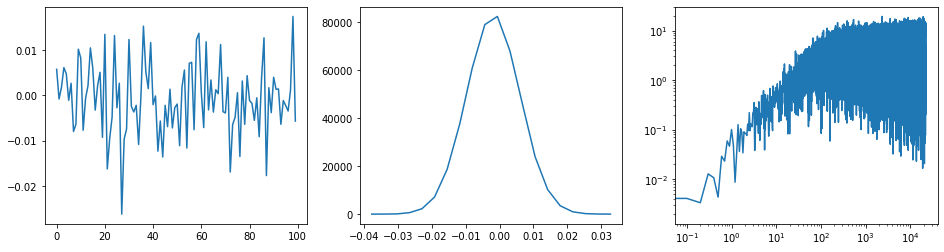

In [824]:
# dithering noise (gaussian psd)
N = x_test_f.size #input (x lenght)
q_step = (1./128)
dither_std = 1.0*q_step #lowest with still good results

dither_noise_1 = np.random.randn(N)*dither_std
#dither_noise_1 = np.random.triangular(-dither_std,0,dither_std,N) #*dither_std

dither_noise_2 = np.random.randn(N)*dither_std

#noise shaping / dither filtering
lowcut = 100 #14000 #15000
order = 1 #2
#dither_noise_2 = butter_highpass_filter(dither_noise_2, lowcut, sr, order=order)
dither_noise_1 = butter_highpass_filter(dither_noise_1, lowcut, sr, order=order)


dither_noise = dither_noise_1# + dither_noise_2

smooth = 1
dither_noise_psd,freq  = compute_psd(dither_noise,sr,smooth)


plt.figure(figsize=(16,4))
plt.subplot(1,3,1)
plt.plot(dither_noise[:100])
plt.subplot(1,3,2)
hist = np.histogram(dither_noise,bins=20)
plt.plot(hist[1][:-1],hist[0])

plt.subplot(1,3,3)
plt.yscale('log')
plt.xscale('log')
plt.plot(freq,dither_noise_psd)

In [763]:
dither_noise = create_dithering_noise(x_test_f.shape,sr,1,100,"triangular")

In [956]:
# BEST PARAMETERS: ch12, std2, cutoff17000 order2 pdf=triangualr
ch=12
std = 2.00
cutoff = 17000
order = 2
pdf = "triangular"
x_test_multidither = []
for i in range(ch):
    x_dither = x_test_f +  create_dithering_noise(x_test_f.shape,sr,std,cutoff,order,pdf)
    x_dither_q = (x_dither*0.5*256.).round().clip(min=-128, max=127)/(128.)
    
    x_test_multidither.append(x_dither_q)
x_test_multidither = np.array(x_test_multidither)
print(x_test_multidither.shape)

(12, 441000)


In [957]:
x_avg = x_test_multidither.mean(0)
ipd.Audio(x_avg,rate=sr)

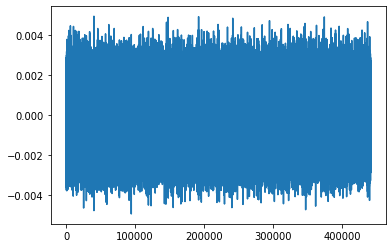

In [958]:
plt.plot(x_test_f-x_avg)

In [959]:
x_avg_triangular
ipd.Audio(x_avg_triangular,rate=sr) 

In [820]:
ipd.Audio(x_test_f,rate=sr)

In [884]:
ipd.Audio(x_test_multidither[0],rate=sr)

In [785]:
dither_noise_norm = dither_noise
ipd.Audio(dither_noise,rate=sr)

In [145]:
# DITHERING/FILTERING
x_test_dither = x_test_f +  dither_noise
ipd.Audio(x_test_dither,rate=sr)

In [689]:
highcut = 7000
order = 2
#x_test_dither = butter_lowpass_filter(x_test_dither, highcut, sr, order=order)
#x_test_filt_q = x_test_q

b, a = butter_lowpass(highcut, sr, order=order)
w, h = freqz(b, a, worN=2000)
#plt.figure(figsize=(4,2,))
#plt.plot((sr * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

In [146]:
# Quantization

x_test_ditherq = (x_test_dither*0.5*256.).round().clip(min=-128, max=127)/(128.)
x_test_naiveq = (x_test_f*0.5*256.).round().clip(min=-128, max=127)/(128.)

x_qerror_dither = x_test_f-x_test_ditherq
x_qerror_naive = x_test_f-x_test_naiveq

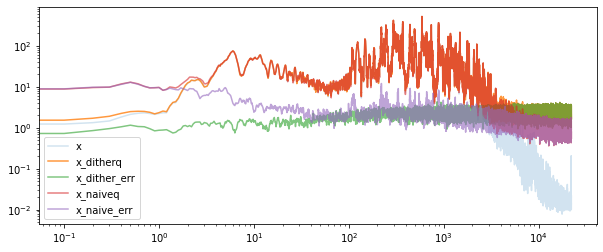

In [147]:
#plt_psd(y_pred_f,sr)
smooth=10
x_psd,freq = compute_psd(x_test_f,sr,smooth)
x_psd_ditherq,freq = compute_psd(x_test_ditherq,sr,smooth)
x_psd_naiveq,freq = compute_psd(x_test_naiveq,sr,smooth)

x_psd_qerror_dither,freq  = compute_psd(x_qerror_dither,sr,smooth)
x_psd_qerror_naive,freq  = compute_psd(x_qerror_naive,sr,smooth)

#y_pred_filt_psd,freq = compute_psd(y_pred_filt,sr,smooth)
#y_test_f_psd,freq = compute_psd(y_test_f,sr,smooth)

scaling='log'
plt.figure(figsize=(10,4))
plt.yscale(scaling)
plt.xscale(scaling)

plt.plot(freq,x_psd,alpha=0.2,label="x")

plt.plot(freq,x_psd_ditherq,alpha=0.8,label="x_ditherq")
plt.plot(freq,x_psd_qerror_dither,alpha=0.6,label="x_dither_err")

plt.plot(freq,x_psd_naiveq,alpha=0.6,label="x_naiveq")
plt.plot(freq,x_psd_qerror_naive,alpha=0.6,label="x_naive_err")

plt.legend()


#plt.plot(freq,y_test_f_psd)
#plt.plot(freq,y_pred_filt_psd)

In [148]:
dither_noise[0]=1
ipd.Audio(dither_noise,rate=sr)

In [149]:
ipd.Audio(x_test_f,rate=sr)

In [150]:
ipd.Audio(x_test_ditherq,rate=sr)

In [151]:
x_qerror_dither_norm = x_qerror_dither.copy()
x_qerror_dither_norm[0]=0.9
ipd.Audio(x_qerror_dither_norm,rate=sr)

In [152]:
ipd.Audio(x_test_naiveq,rate=sr)

In [153]:
x_qerror_naive_norm = x_qerror_naive.copy()
x_qerror_naive_norm[0]=0.5
ipd.Audio(x_qerror_naive_norm,rate=sr)

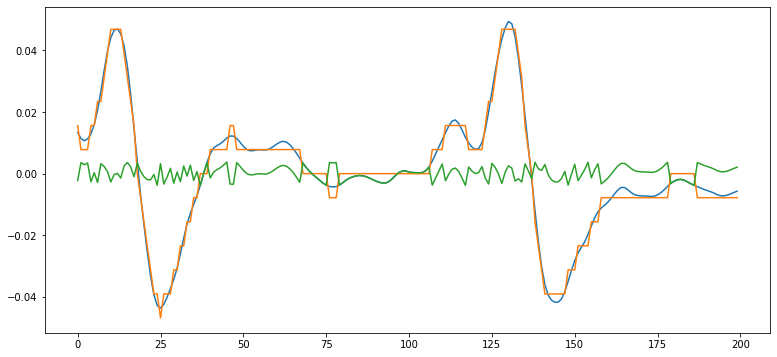

In [154]:
sampl = 200
plt.figure(figsize=(13,6))
plt.plot(x_test_f[:sampl])
plt.plot(x_test_naiveq[:sampl])
#plt.plot(x_test_filt_q[:sampl])

plt.plot(x_qerror_naive[:sampl])

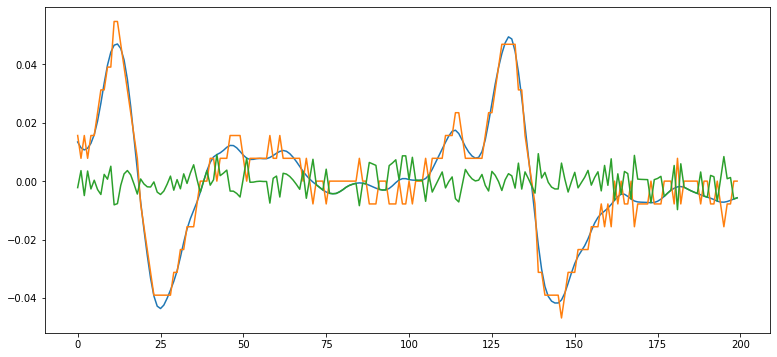

In [155]:
sampl = 200
plt.figure(figsize=(13,6))
plt.plot(x_test_f[:sampl])
#plt.plot(x_test_dither[:sampl])
plt.plot(x_test_ditherq[:sampl])
plt.plot(x_qerror_dither[:sampl])

In [156]:
def wavenet_predict(x,model):
    pad_x_test = prepare_x(x.reshape(x_test.shape)).astype(np.float32)
    y_pred = []
    for x in np.array_split(pad_x_test, 10):
        y_pred.append(model(torch.from_numpy(x)).detach().numpy())
    y_pred = np.concatenate(y_pred)
    y_pred = y_pred[:, :, -x_test.shape[2] :]
    y_pred_f = np.concatenate(y_pred.squeeze())
    return y_pred_f
    

In [157]:
#predict
y_pred_ditherq = wavenet_predict(x_test_ditherq,model)

In [158]:
y_pred_naiveq = wavenet_predict(x_test_naiveq,model)

In [159]:
ipd.Audio(y_pred_ditherq,rate=sr)

In [160]:
ipd.Audio(y_pred_naiveq,rate=sr)

In [161]:
ipd.Audio(y_test_f,rate=sr)

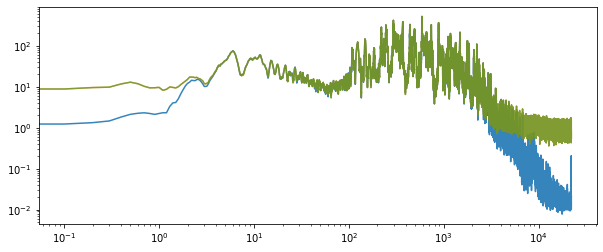

In [186]:
#plt_psd(y_pred_f,sr)
smooth=10
x_psd,freq = compute_psd(x_test_f,sr,smooth)
x_psd_q,freq = compute_psd(x_test_q,sr,smooth)
x_psd_naiveq,freq = compute_psd(x_test_naiveq,sr,smooth)

#y_pred_filt_psd,freq = compute_psd(y_pred_filt,sr,smooth)
#y_test_f_psd,freq = compute_psd(y_test_f,sr,smooth)

scaling='log'
plt.figure(figsize=(10,4))
plt.yscale(scaling)
plt.xscale(scaling)

plt.plot(freq,x_psd,alpha=0.9)
plt.plot(freq,x_psd_q,alpha=0.8)

plt.plot(freq,x_psd_naiveq,alph§a=0.6)

#plt.plot(freq,y_test_f_psd)
#plt.plot(freq,y_pred_filt_psd)

#### Analysis Quantization

Without Dithering
1. quant noise is very harsh when input is quite... ma vaaa

With naive gaussian dithering


## FILTERING TEST

In [90]:
#FILTERING TEST
y_pred_flat = np.concatenate(y_pred.squeeze().detach().numpy())

In [91]:
y_pred_flat = y_pred_flat - y_pred_flat.mean()

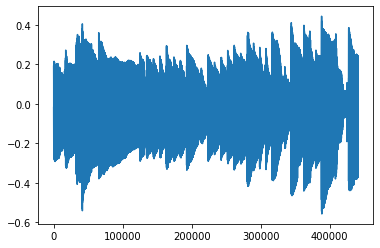

In [92]:
plt.plot(y_pred_flat)

In [93]:
ipd.Audio(y_pred_flat,rate=sr)

In [47]:
ipd.Audio(np.concatenate(x_test.squeeze()),rate=sr)

In [61]:
ipd.Audio(np.concatenate(y_test.squeeze()),rate=sr)

In [39]:
#quantize y test
x_test = (x_test*0.5*256.).round().clip(min=-128, max=127)/(128.)
y_test = (y_test*0.5*256.).round().clip(min=-128, max=127)/(128.)

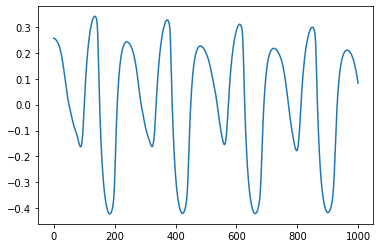

In [88]:
plt.plot(y_test[70,0,:1000])

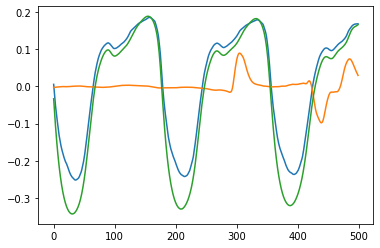

In [89]:
sample = 30
n_sampl = 500
plt.plot(y_pred[sample].squeeze().detach().numpy()[:n_sampl])
plt.plot(x_test[sample].squeeze()[-out_sample_size:-out_sample_size+n_sampl])
plt.plot(y_test[sample].squeeze()[:n_sampl])

In [43]:
outputs = model(inputs)

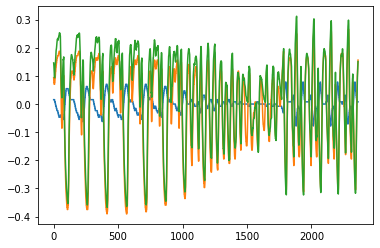

In [90]:
i = 250
plt.plot(inputs[i,:,-out_sample_size:].flatten().detach())
plt.plot(target[i].flatten().detach())
plt.plot(outputs[i].flatten().detach())

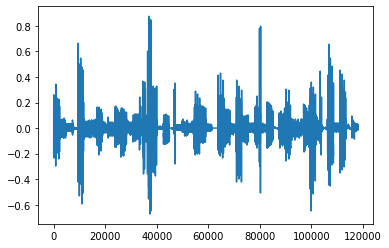

In [60]:
### plt.plot(inputs[0:50].flatten().detach())
#plt.plot(outputs[0:50].flatten().detach())
plt.plot((target)[0:50].flatten().detach())
#plt.plot((target*0.5-0.3)[0:50].flatten().detach())

## OTHER SHIT

In [30]:
#inp = torch.ones(1,1,4410)
#inp = ((torch.rand(1,1,4410)-0.5)*4.0).clamp(-2,2)
t = np.linspace(0,10,4410)
inp = torch.tensor(np.sin(t*100))*2
inp = inp.reshape(1,1,4410).float()

In [31]:
model.input_layer.op.weight.data[:,0,:] = torch.tensor([0,0,1])
#model.input_layer.op.weight.data[1,0,:] = torch.tensor([0,0,-1])
model.input_layer.op.weight.data[:,1:,:] = torch.tensor([0,0,0])
model.input_layer.op.bias.data[:] = 0

for l in model.hidden:
    l.op.weight.data[:,0,:] = torch.tensor([0,0,1])
    l.op.weight.data[:,1:,:] = torch.tensor([0,0,0])
    l.op.bias.data[:] = 0
model.linear_mix.op.weight.data[:,:,0] = torch.tensor([10,0,0,0,0,0,0,0,0,0,0,0])

In [32]:
out = model(inp)

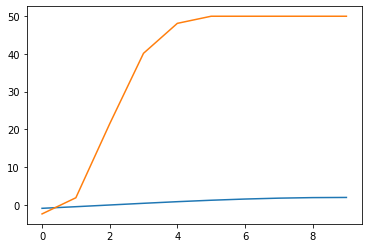

In [33]:
n = 10
plt.plot(inp[0,0,-out_sample_size:-out_sample_size+n].detach())
plt.plot(out[0,0,:n].detach())

In [150]:
for module in model.modules():
    if isinstance(module, ai8x.FusedConv1dReLU):
        module.clamp = ai8x.Empty()
    

In [151]:
model

AI85tcn(
  (hidden): ModuleList(
    (0): FusedConv1dReLU(
      (activate): ReLU(inplace=True)
      (op): Conv1d(12, 12, kernel_size=(3,), stride=(1,))
      (calc_out_shift): OutputShiftSqueeze()
      (calc_weight_scale): One()
      (scale): Scaler()
      (calc_out_scale): OutputScale()
      (quantize_weight): Empty()
      (quantize_bias): Empty()
      (clamp_weight): Empty()
      (clamp_bias): Empty()
      (quantize): Empty()
      (clamp): Empty()
      (quantize_pool): Empty()
      (clamp_pool): Empty()
    )
    (1): FusedConv1dReLU(
      (activate): ReLU(inplace=True)
      (op): Conv1d(12, 12, kernel_size=(3,), stride=(1,), dilation=(2,))
      (calc_out_shift): OutputShiftSqueeze()
      (calc_weight_scale): One()
      (scale): Scaler()
      (calc_out_scale): OutputScale()
      (quantize_weight): Empty()
      (quantize_bias): Empty()
      (clamp_weight): Empty()
      (clamp_bias): Empty()
      (quantize): Empty()
      (clamp): Empty()
      (quantize_pool): 